In [1]:
import math
import uuid
from collections import deque
from pathlib import Path
from uuid import UUID

import matplotlib.colors as pltcolors
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.collections import LineCollection

Matplotlib is building the font cache; this may take a moment.


In [2]:
plt.style.use("default")
plt.rcParams.update(
    {
        "savefig.pad_inches": 0,
        "axes.titlesize": 8,
        "axes.titlepad": 3,
        "axes.labelsize": 8,
        "legend.fontsize": 8,
    }
)
figsuffix: str = ".pdf"
figdpi: int = 600
FIGUREROOT = Path("../fig")

# Read River Network Definitions

In [3]:
CJRIVERFILE = Path("../data/yangtze_river_network.csv")

downstream_cj: dict[UUID, UUID | None] = {}
geometry_cj: dict[UUID, tuple[list[float], list[float]]] = {}

with open(CJRIVERFILE, "rt") as f:
    lines = f.readlines()
    for line in lines[1:]:
        line_parts = line.strip().split(",")
        cid = UUID(line_parts[0])
        did = UUID(line_parts[1]) if line_parts[1] != "" else None
        downstream_cj[cid] = did
        lon1 = float(line_parts[2])
        lat1 = float(line_parts[3])
        lon2 = float(line_parts[4])
        lat2 = float(line_parts[5])
        data = (
            [lon1, lon2],
            [lat1, lat2],
        )
        geometry_cj[cid] = data

In [4]:
print([x for x, y in downstream_cj.items() if y is None or y not in downstream_cj])

[UUID('a2e6ca56-ee63-48a1-80ca-095f32965535')]


In [5]:
def find_upstream(downstream: dict[UUID, UUID | None]) -> dict[UUID, list[UUID]]:
    upstream: dict[UUID, list[UUID]] = {k: [] for k in downstream.keys()}
    for uid, did in downstream.items():
        if did is not None and did in upstream:
            upstream[did].append(uid)
    return upstream

In [6]:
def find_subnet(
    downstream: dict[UUID, UUID | None], outlet: UUID
) -> dict[UUID, UUID | None]:
    subnet = {}

    upstreams = find_upstream(downstream)

    todo = [outlet]
    while todo:
        cid = todo.pop()
        subnet[cid] = downstream[cid]
        todo.extend(upstreams[cid])
    return subnet

In [7]:
def downstream_depth(downstream: dict[UUID, UUID | None]) -> dict[UUID, int]:
    depth = {}
    for rid in downstream.keys():
        cdepth = 0
        cid = downstream[rid]
        while cid and cid in downstream:
            cdepth += 1
            cid = downstream[cid]
        depth[rid] = cdepth
    return depth

In [8]:
upstream_cj = find_upstream(downstream_cj)

print(
    len(downstream_cj),
    len([x for x, y in downstream_cj.items() if y is None or y not in downstream_cj]),
)

53600 1


# Calculate Stream Order

In [9]:
def valid_order(
    order: dict[UUID, list[UUID]], downstream: dict[UUID, UUID | None]
) -> bool:
    for rid, did in downstream.items():
        if rid not in order:
            return False
        if did is not None:
            if did not in order or order[did] <= order[rid]:
                return False
    return True

In [10]:
# strahler order
def calculate_strahler_order(
    downstream: dict[UUID, UUID | None], upstream: dict[UUID, list[UUID]] | None = None
) -> dict[UUID, int]:
    order: dict[UUID, int] = {}
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )
    # the outermost rivers have order 1
    current = set(k for k, v in upstreams.items() if len(v) == 0)
    for k in current:
        order[k] = 1
    # the rest of the rivers
    prev, current = current, set()
    while len(order) < len(downstream):
        current.clear()
        for cid in prev:
            did = downstream[cid]
            if (
                did is not None
                and did in upstreams
                and all(k in order for k in upstreams[did])
            ):
                current.add(did)
        for k in current:
            max_order = max(order[u] for u in upstreams[k])
            min_order = min(order[u] for u in upstreams[k])
            if max_order == min_order:
                order[k] = max_order + 1
            else:
                order[k] = max_order
        prev, current = current, prev

    return order


strahler_order_cj = calculate_strahler_order(downstream_cj)

In [11]:
# shreve order
def calculate_shreve_order(
    downstream: dict[UUID, UUID | None], upstream: dict[UUID, list[UUID]] | None = None
) -> dict[UUID, int]:
    order: dict[UUID, int] = {}
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )
    # the outermost rivers have order 1
    current = set(k for k, v in upstreams.items() if len(v) == 0)
    for k in current:
        order[k] = 1
    # the rest of the rivers
    prev, current = current, set()
    while len(order) < len(downstream):
        current.clear()
        for cid in prev:
            did = downstream[cid]
            if (
                did is not None
                and did in upstreams
                and all(k in order for k in upstreams[did])
            ):
                current.add(did)
        for k in current:
            order[k] = sum(order[u] for u in upstreams[k])
        prev, current = current, prev

    return order


shreve_order_cj = calculate_shreve_order(downstream_cj)

In [12]:
# zheng order
def calculate_zheng_order(
    downstream: dict[UUID, UUID | None], upstream: dict[UUID, list[UUID]] | None = None
) -> dict[UUID, int]:
    order: dict[UUID, int] = {}
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )
    # the outermost rivers have order 1
    current = set(k for k, v in upstreams.items() if len(v) == 0)
    for k in current:
        order[k] = 1
    # the rest of the rivers
    prev, current = current, set()
    while len(order) < len(downstream):
        current.clear()
        for cid in prev:
            did = downstream[cid]
            if (
                did is not None
                and did in upstreams
                and all(k in order for k in upstreams[did])
            ):
                current.add(did)
        for k in current:
            order[k] = max(order[u] for u in upstreams[k]) + 1
        prev, current = current, prev

    return order


zheng_order_cj = calculate_zheng_order(downstream_cj)

In [13]:
# reversed zheng  order
def calculate_zheng_order_reversed(
    downstream: dict[UUID, UUID | None], upstream: dict[UUID, list[UUID]] | None = None
) -> dict[UUID, int]:
    order: dict[UUID, int] = {}
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )
    # the downmost rivers have order 1
    current = set(k for k, v in downstream.items() if (v is None or v not in upstreams))
    for k in current:
        order[k] = 1
    # the rest of the rivers
    prev, current = current, set()
    while len(order) < len(downstream):
        current.clear()
        for cid in prev:
            uids = upstreams[cid]
            for uid in uids:
                current.add(uid)
        for k in current:
            did = downstream[k]
            if did is not None:
                order[k] = order[did] + 1
        prev, current = current, prev

    # reverse the order
    max_order = max(order.values())
    for k, v in order.items():
        order[k] = max_order - v + 1
    return order


zheng_rorder_cj: dict[UUID, int] = calculate_zheng_order_reversed(downstream_cj)

# Breakdown

In [14]:
def find_longest_path(
    downstream: dict[UUID, UUID | None], outlets_input: list[UUID] | None = None
) -> list[list[UUID]]:
    if outlets_input:
        outlets = outlets_input
    else:
        outlets = [k for k, v in downstream.items() if v is None or v not in downstream]
    if len(outlets) == 0:
        return [[]]
    paths = []
    for outlet in outlets:
        subnet = find_subnet(downstream, outlet)
        rorder = calculate_zheng_order_reversed(subnet)
        head = [k for k, v in rorder.items() if v == 1]
        head_down = {downstream[k]: k for k in head}
        head = list(head_down.values())
        path = [head[0]]  # randomly choose one as the head
        if path[0] != outlet:
            while did := subnet[path[-1]]:
                path.append(did)
                if did == outlet:
                    break
        paths.append(path)
    return paths

In [15]:
def breakdown(
    downstream: dict[UUID, UUID | None], max_length: int, halo_length: int = 6
) -> tuple[dict[UUID, UUID | None], dict[UUID, UUID]]:
    down = downstream.copy()
    halo = {}
    upstreams = find_upstream(down)
    longest_paths = find_longest_path(down)
    breakpoint: list[UUID] = []
    breakpoint_upstream: list[UUID] = []
    for path in longest_paths:
        if len(path) > max_length:
            for i in range(0, len(path), max_length):
                breakpoint.append(path[i])
                breakpoint_upstream.append(path[i - 1])
    for did, did_up in zip(breakpoint, breakpoint_upstream):
        uid = did_up
        ups = [
            uid,
        ]
        down[uid] = None
        nid = uuid.uuid4()
        down[nid] = did
        halo[nid] = uid

        ups_next = ups
        for _ in range(halo_length - 1):
            ups, ups_next = ups_next, []
            for rid in ups:
                for uid in upstreams[rid]:
                    ups_next.append(uid)
                    nid = uuid.uuid4()
                    down[nid] = rid
                    halo[nid] = uid
    return down, halo

# Parallelization Machine

In [16]:
def measure_executation(order: dict[UUID, int], np: int = 1):
    sorted_order = sorted(order.items(), key=lambda x: x[1])
    deficiency: dict[UUID, float] = {}
    cycle = 0
    ibeg: int = 0
    iend: int = 0
    while True:
        ibeg = iend
        for _ in range(np):
            if (
                iend < len(sorted_order)
                and sorted_order[iend][1] == sorted_order[ibeg][1]
            ):
                iend += 1
            else:
                break
        if iend == ibeg:
            break
        for i in range(ibeg, iend):
            deficiency[sorted_order[i][0]] = (np - (iend - ibeg)) / np
        cycle += 1
    return cycle, deficiency

In [17]:
def order_count(order: dict[UUID, int]) -> dict[int, int]:
    count4order: dict[int, int] = {}
    for v in order.values():
        count4order[v] = count4order.get(v, 0) + 1
    order4count: dict[int, int] = {}
    for v in count4order.values():
        order4count[v] = order4count.get(v, 0) + 1
    return order4count

# Yangtze River

In [18]:
downstream_cj_bd1, halo_cj_bd2 = breakdown(
    downstream_cj, math.ceil(max(zheng_order_cj.values()) / 2)
)
zheng_rorder_cj_bd1 = calculate_zheng_order_reversed(downstream_cj_bd1)
zheng_order_cj_bd1 = calculate_zheng_order(downstream_cj_bd1)

print(
    [
        (x, zheng_rorder_cj_bd1[x], x in downstream_cj)
        for x, y in downstream_cj_bd1.items()
        if y is None or y not in downstream_cj_bd1
    ]
)

[(UUID('a2e6ca56-ee63-48a1-80ca-095f32965535'), 639, True), (UUID('809d51b4-ec32-43a3-9340-832363a15b4e'), 639, True)]


In [19]:
downstream_cj_bd3, halo_cj_bd4 = breakdown(
    downstream_cj, math.ceil(max(zheng_order_cj.values()) / 4)
)

zheng_rorder_cj_bd3 = calculate_zheng_order_reversed(downstream_cj_bd3)
zheng_order_cj_bd3 = calculate_zheng_order(downstream_cj_bd3)

print(
    [
        (x, zheng_rorder_cj_bd3[x], x in downstream_cj)
        for x, y in downstream_cj_bd3.items()
        if y is None or y not in downstream_cj_bd3
    ]
)

[(UUID('a2e6ca56-ee63-48a1-80ca-095f32965535'), 380, True), (UUID('6a994836-4e7b-4f72-90f9-93948c22dfbb'), 380, True), (UUID('fcc57d7c-60d8-4d0e-848e-502664a30876'), 380, True), (UUID('6aa21ade-63e7-4477-b5ac-bc34e0d4e124'), 380, True)]


In [20]:
def plot_yangtze(ax):
    ax.set_aspect("equal")
    ax.set_xlim(90, 122)
    ax.set_ylim(24.2, 36)
    ax.set_xticks(
        [90, 95, 100, 105, 110, 115, 120],
        ["90°E", "", "100°E", "", "110°E", "", "120°E"],
    )
    ax.set_yticks(
        [26, 28, 30, 32, 34, 36], ["26°N", "28°N", "30°N", "32°N", "34°N", "36°N"]
    )

In [21]:
MAX_NP = 1000

perfect_speedup = [x for x in range(1, MAX_NP + 1)]
theory_limit_cj = [
    len(zheng_order_cj) / max(zheng_order_cj.values()) for x in range(1, MAX_NP + 1)
]

shreve_order_cj_speedup: list[float] = [
    len(shreve_order_cj) / measure_executation(shreve_order_cj, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_order_cj_speedup = [
    len(zheng_order_cj) / measure_executation(zheng_order_cj, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_rorder_cj_speedup = [
    len(zheng_rorder_cj) / measure_executation(zheng_rorder_cj, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_rorder_cj_bd1_speedup = [
    len(zheng_rorder_cj) / measure_executation(zheng_rorder_cj_bd1, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_rorder_cj_bd3_speedup = [
    len(zheng_rorder_cj) / measure_executation(zheng_rorder_cj_bd3, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_order_cj_bd1_speedup = [
    len(zheng_order_cj) / measure_executation(zheng_order_cj_bd1, np)[0]
    for np in range(1, MAX_NP + 1)
]

zheng_order_cj_bd3_speedup = [
    len(zheng_order_cj) / measure_executation(zheng_order_cj_bd3, np)[0]
    for np in range(1, MAX_NP + 1)
]

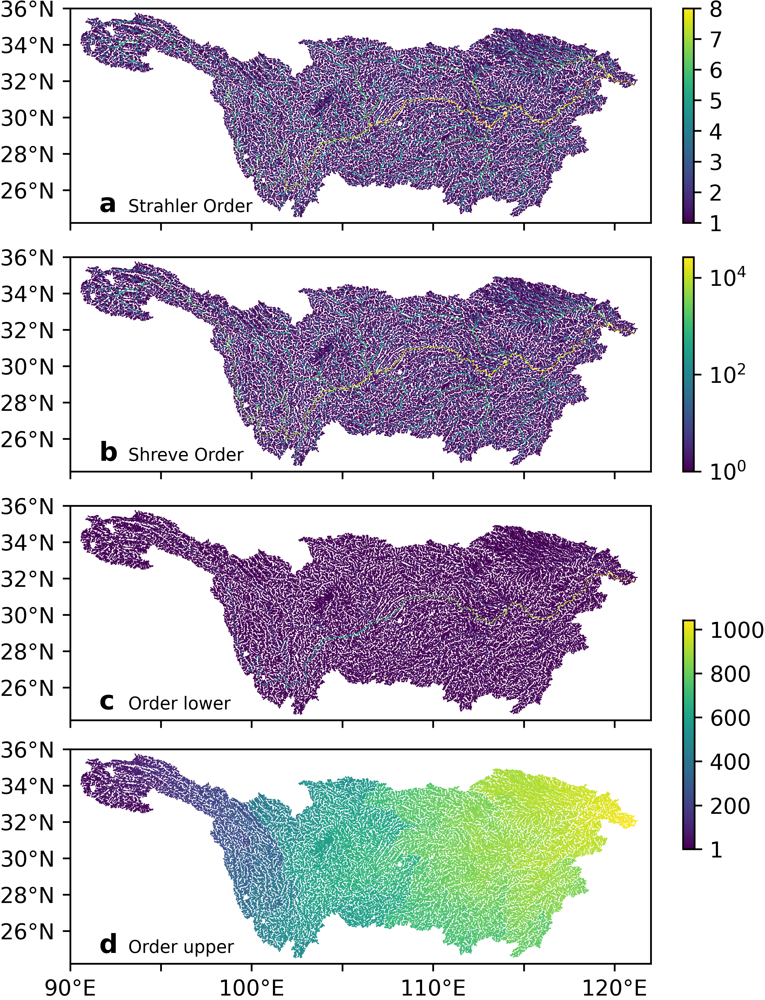

In [22]:
fig = plt.figure(figsize=(12.5 / 2.54, 16.4 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(4, 1, sharex=True, sharey=True, squeeze=False)

# Create a continuous norm to map from data points to colors
ax = axs[0, 0]
seg = [np.zeros((2, 2)) for _ in range(len(downstream_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = strahler_order_cj[rid]

norm = pltcolors.Normalize(1, max(o for o in strahler_order_cj.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)
cb = plt.colorbar(line, ax=ax)
cb.set_ticks([1, 2, 3, 4, 5, 6, 7, 8])

ax.text(0.05, 0.05, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Strahler Order", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)
ax.set_xticklabels([])

ax = axs[1, 0]
seg = [np.zeros((2, 2)) for _ in range(len(geometry_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = shreve_order_cj[rid]

norm = pltcolors.LogNorm(1, max(o for o in shreve_order_cj.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)
plt.colorbar(line, ax=ax)

ax.text(0.05, 0.05, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Shreve Order", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)
ax.set_xticklabels([])

plot_yangtze(ax)
ax.set_xticklabels([])

ax = axs[2, 0]
seg = [np.zeros((2, 2)) for _ in range(len(geometry_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = zheng_order_cj[rid]

norm = pltcolors.Normalize(1, max(o for o in zheng_order_cj.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

ax.text(0.05, 0.05, "c", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order lower", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)
ax.set_xticklabels([])

ax = axs[3, 0]
seg = [np.zeros((2, 2)) for _ in range(len(geometry_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = zheng_rorder_cj[rid]

norm = pltcolors.Normalize(1, max(o for o in zheng_rorder_cj.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)
cb = plt.colorbar(line, ax=axs[2:, 0], shrink=0.5)
cb.set_ticks(
    [
        1,
        200,
        400,
        600,
        800,
        1000,
    ]
)
ax.text(0.05, 0.05, "d", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order upper", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)

plt.savefig(
    FIGUREROOT.joinpath("spatial_distribution_yangtze").with_suffix(figsuffix),
    dpi=figdpi,
)

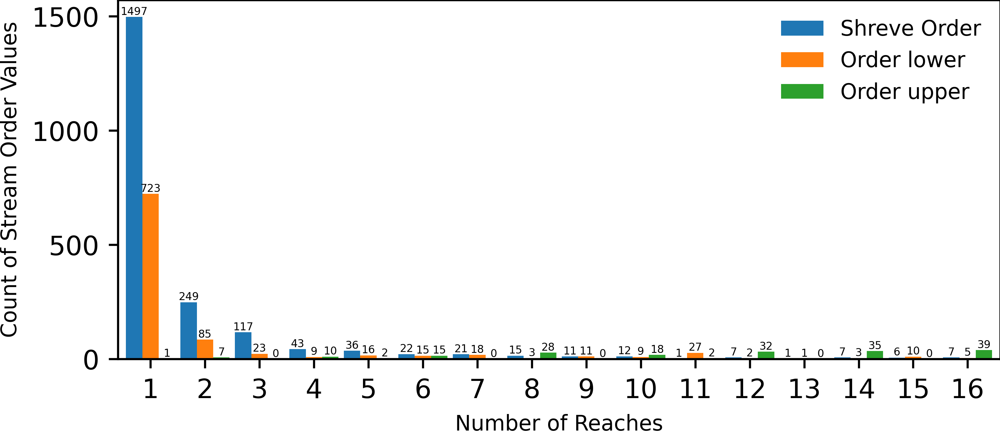

In [23]:
count_shreve_order = order_count(shreve_order_cj)
count_zheng_order = order_count(zheng_order_cj)
count_zheng_rorder = order_count(zheng_rorder_cj)

fig = plt.figure(figsize=(13.5 / 2.54, 6 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(1, 1, sharex=True, sharey=True, squeeze=False)

ax = axs[0, 0]

x = list(range(1, 17))
data_shreve_y = [count_shreve_order[i] for i in x]
data_zheng_y = [count_zheng_order.get(i, 0) for i in x]
data_zheng_r_y = [count_zheng_rorder.get(i, 0) for i in x]

bar1 = ax.bar(
    [xx - 0.3 for xx in x],
    data_shreve_y,
    width=0.3,
    align="center",
    label="Shreve Order",
)
ax.bar_label(bar1, fontsize=4)

bar2 = ax.bar(x, data_zheng_y, width=0.3, align="center", label="Order lower")
ax.bar_label(bar2, fontsize=4)

bar3 = ax.bar(
    [xx + 0.3 for xx in x],
    data_zheng_r_y,
    width=0.3,
    align="center",
    label="Order upper",
)
ax.bar_label(bar3, fontsize=4)

plt.legend(frameon=False, fontsize=8)

ax.set_xticks(x)
ax.set_xlim(0.4, x[-1] + 0.6)
ax.set_xlabel("Number of Reaches")
ax.set_ylabel("Count of Stream Order Values")

plt.savefig(
    FIGUREROOT.joinpath("stream_count_yangtze").with_suffix(figsuffix),
    dpi=figdpi,
)

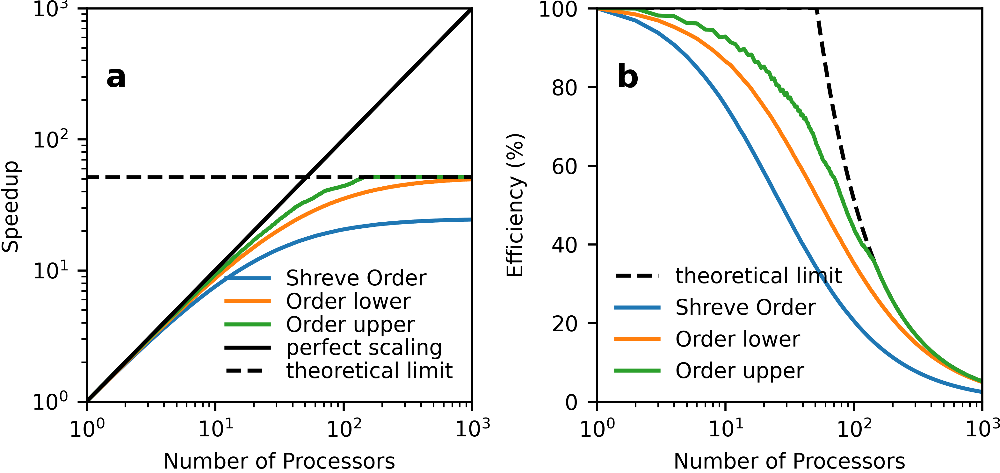

In [24]:
fig = plt.figure(figsize=(13.5 / 2.54, 6.5 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(1, 2, sharex=False, sharey=False, squeeze=False)

ax = axs[0, 0]
data_x = list(range(1, MAX_NP + 1))
ax.plot(data_x, shreve_order_cj_speedup, label="Shreve Order")
ax.plot(data_x, zheng_order_cj_speedup, label="Order lower")
ax.plot(data_x, zheng_rorder_cj_speedup, label="Order upper")
ax.plot(data_x, perfect_speedup, label="perfect scaling", color="k")
ax.plot(theory_limit_cj, label="theoretical limit", color="k", linestyle="--")
ax.set_xlim(1, MAX_NP)
ax.set_ylim(1, MAX_NP)
ax.set_yscale("log")
ax.set_xscale("log")
ax.legend(fontsize=8, loc="lower right", frameon=False, labelspacing=0.1)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Speedup")
ax.text(0.05, 0.8, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")

ax.tick_params(labelsize=8)


ax = axs[0, 1]
data_x = list(range(1, MAX_NP + 1))
ax.plot(
    data_x,
    [
        min((x / y) * 100.0, 100)
        for x, y in zip(theory_limit_cj, perfect_speedup[:MAX_NP])
    ],
    label="theoretical limit",
    color="k",
    linestyle="--",
)
ax.plot(
    data_x,
    [(x / y) * 100.0 for x, y in zip(shreve_order_cj_speedup, perfect_speedup)],
    label="Shreve Order",
)
ax.plot(
    data_x,
    [(x / y) * 100.0 for x, y in zip(zheng_order_cj_speedup, perfect_speedup)],
    label="Order lower",
)
ax.plot(
    data_x,
    [(x / y) * 100.0 for x, y in zip(zheng_rorder_cj_speedup, perfect_speedup)],
    label="Order upper",
)
ax.set_xlim(1, MAX_NP)
ax.set_ylim(0, 100)
ax.set_xscale("log")
ax.legend(fontsize=8, frameon=False)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Efficiency (%)")
ax.text(0.05, 0.8, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")


ax.tick_params(labelsize=8)

fig.savefig(
    FIGUREROOT.joinpath("speedup_yangtze").with_suffix(".pdf"),
    dpi=figdpi,
)

In [25]:
print(
    np.nonzero([y > x for x, y in zip(theory_limit_cj, perfect_speedup)])[0][0].item(),
    len(downstream_cj) / len(find_longest_path(downstream_cj)[0]),
)

51 51.43953934740883


In [26]:
(
    shreve_order_cj_speedup[-1],
    len(downstream_cj) / len(set(shreve_order_cj.values())),
    theory_limit_cj[-1],
    zheng_order_cj_speedup[-1],
    zheng_rorder_cj_speedup[-1],
)

(24.452554744525546,
 24.872389791183295,
 51.43953934740883,
 49.58371877890842,
 51.43953934740883)

In [27]:
print(
    np.nonzero(
        [x / shreve_order_cj_speedup[-1] >= 0.90 for x in shreve_order_cj_speedup]
    )[0][0].item(),
    np.nonzero(
        [x / zheng_order_cj_speedup[-1] >= 0.90 for x in zheng_order_cj_speedup]
    )[0][0].item(),
    np.nonzero(
        [x / zheng_order_cj_speedup[-1] >= 0.90 for x in zheng_order_cj_speedup]
    )[0][0].item(),
)

158 279 279


In [28]:
print(
    np.nonzero(
        [x / y >= 0.8 for x, y in zip(shreve_order_cj_speedup, perfect_speedup)]
    )[0][-1].item(),
    np.nonzero([x / y >= 0.8 for x, y in zip(zheng_order_cj_speedup, perfect_speedup)])[
        0
    ][-1].item(),
    np.nonzero(
        [x / y >= 0.8 for x, y in zip(zheng_rorder_cj_speedup, perfect_speedup)]
    )[0][-1].item(),
)

6 14 25


In [29]:
print(
    np.nonzero(
        [x / y >= 0.99 for x, y in zip(zheng_rorder_cj_speedup, theory_limit_cj)]
    )[0][0].item(),
)

141


In [30]:
zheng_rorder_cj_speedup[141], theory_limit_cj[138]

(51.14503816793893, 51.43953934740883)

51


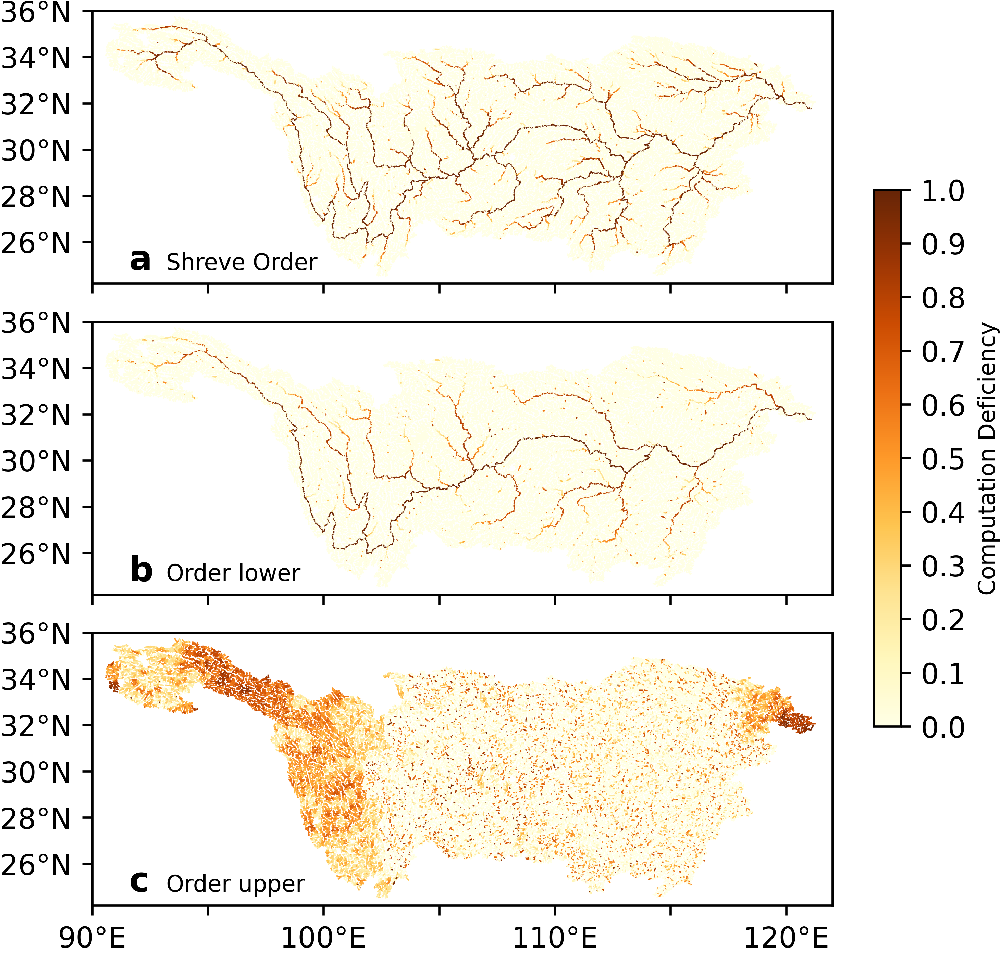

In [31]:
# spatial distribution of cost
np_min = np.nonzero([y > x for x, y in zip(theory_limit_cj, perfect_speedup)])[0][
    0
].item()
print(np_min)


fig = plt.figure(figsize=(12.5 / 2.54, 12 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(3, 1, sharex=True, sharey=True, squeeze=False)

norm = pltcolors.Normalize(0, 1)
cmap = "YlOrBr"

ax = axs[0, 0]
# Create a continuous norm to map from data points to colors
_, reach_deficiency = measure_executation(shreve_order_cj, np_min)
seg = np.zeros((len(geometry_cj), 2, 2))
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii, :, 0] = x
    seg[ii, :, 1] = y
    value[ii] = reach_deficiency[rid]

lc = LineCollection(seg, cmap=cmap, norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

ax.text(0.05, 0.05, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Shreve Order", transform=ax.transAxes, fontsize=8)


plot_yangtze(ax)
ax.set_xticklabels([])

ax = axs[1, 0]
# Create a continuous norm to map from data points to colors
_, reach_deficiency = measure_executation(zheng_order_cj, np_min)
seg = np.zeros((len(geometry_cj), 2, 2))
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii, :, 0] = x
    seg[ii, :, 1] = y
    value[ii] = reach_deficiency[rid]

lc = LineCollection(seg, cmap=cmap, norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

ax.text(0.05, 0.05, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order lower", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)
ax.set_xticklabels([])


ax = axs[2, 0]
# Create a continuous norm to map from data points to colors
_, reach_deficiency = measure_executation(zheng_rorder_cj, np_min)
seg = np.zeros((len(geometry_cj), 2, 2))
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii, :, 0] = x
    seg[ii, :, 1] = y
    value[ii] = reach_deficiency[rid]

lc = LineCollection(seg, cmap=cmap, norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

ax.text(0.05, 0.05, "c", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order upper", transform=ax.transAxes, fontsize=8)

plot_yangtze(ax)


cb = plt.colorbar(line, ax=axs[:, 0], label="Computation Deficiency", shrink=0.6)
cb.set_ticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])


plt.savefig(
    FIGUREROOT.joinpath("computation_deficiency_yangtze").with_suffix(figsuffix),
    dpi=figdpi,
)

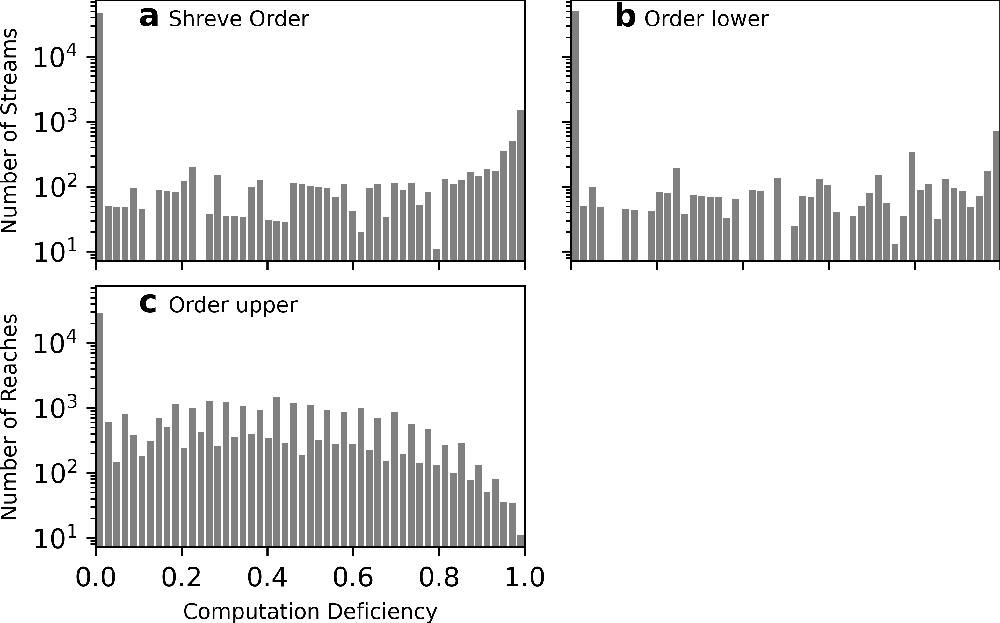

In [32]:
fig = plt.figure(figsize=(13.5 / 2.54, 8.5 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(2, 2, sharex=True, sharey=True, squeeze=False)

ax = axs[0, 0]

_, reach_deficiency = measure_executation(shreve_order_cj, np_min)

ax.hist(
    list(reach_deficiency.values()), range=(0, 1), bins=np_min, rwidth=0.8, color="gray"
)

ax.set_ylabel("Number of Streams")

ax.text(0.1, 0.90, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.17, 0.90, "Shreve Order", transform=ax.transAxes, fontsize=8)

ax = axs[0, 1]

_, reach_deficiency = measure_executation(zheng_order_cj, np_min)

ax.hist(
    list(reach_deficiency.values()), range=(0, 1), bins=np_min, rwidth=0.8, color="gray"
)

ax.text(0.1, 0.90, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.17, 0.90, "Order lower", transform=ax.transAxes, fontsize=8)

ax = axs[1, 0]

_, reach_deficiency = measure_executation(zheng_rorder_cj, np_min)

ax.hist(
    list(reach_deficiency.values()), range=(0, 1), bins=np_min, rwidth=0.8, color="gray"
)
ax.set_yscale("log")
ax.set_xlim(0, 1)
ax.set_xlabel("Computation Deficiency")
ax.set_ylabel("Number of Reaches")

ax.text(0.1, 0.90, "c", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.17, 0.90, "Order upper", transform=ax.transAxes, fontsize=8)

ax = axs[1, 1]
ax.set_visible(False)

plt.savefig(
    FIGUREROOT.joinpath("computation_cost_hist_yangtze").with_suffix(figsuffix),
    dpi=figdpi,
)

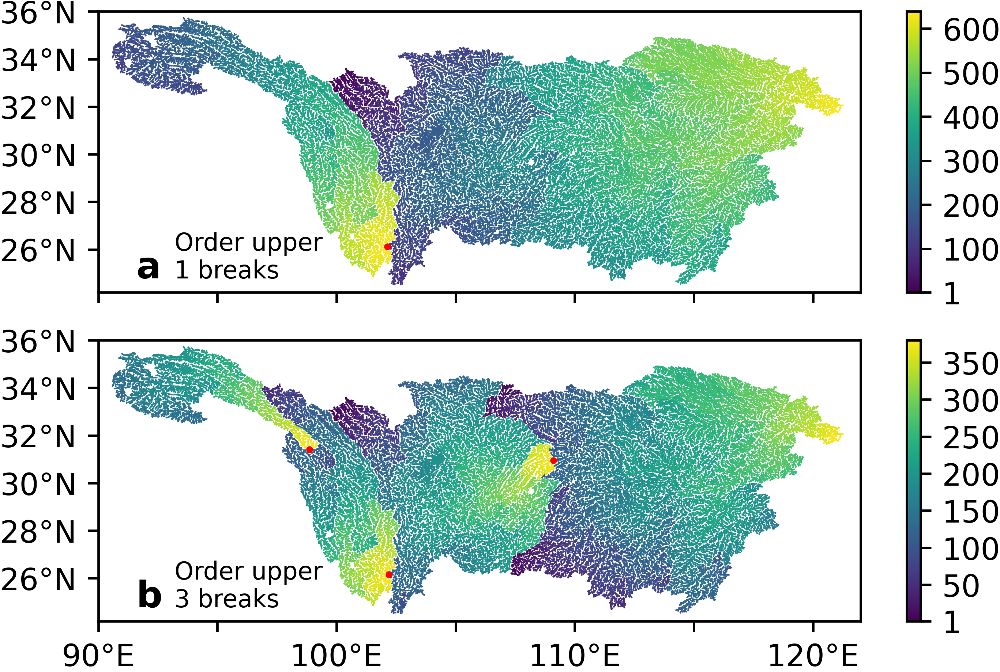

In [33]:
fig = plt.figure(figsize=(12.5 / 2.54, 8 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(2, 1, sharex=True, sharey=True, squeeze=False)

# Create a continuous norm to map from data points to colors
ax = axs[0, 0]
seg = [np.zeros((2, 2)) for _ in range(len(geometry_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = zheng_rorder_cj_bd1[rid]

norm = pltcolors.Normalize(1, max(o for o in zheng_rorder_cj_bd1.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

breakpoints = [
    x
    for x, y in downstream_cj_bd1.items()
    if (y is None or y not in downstream_cj_bd1) and downstream_cj[x] is not None
]
tmpx = []
tmpy = []
for bb in breakpoints:
    tmpx.append(geometry_cj[bb][0][-1])
    tmpy.append(geometry_cj[bb][1][-1])
ax.scatter(tmpx, tmpy, s=6, color="r", marker=".", zorder=2.5)


cb = plt.colorbar(line, ax=ax)
cb.set_ticks(
    [
        1,
        100,
        200,
        300,
        400,
        500,
        600,
    ]
)

plot_yangtze(ax)
ax.set_xticklabels([])

ax.text(0.05, 0.05, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order upper\n1 breaks", transform=ax.transAxes, fontsize=8)

ax = axs[1, 0]
seg = [np.zeros((2, 2)) for _ in range(len(geometry_cj))]
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii][:, 0] = x
    seg[ii][:, 1] = y
    value[ii] = zheng_rorder_cj_bd3[rid]

norm = pltcolors.Normalize(1, max(o for o in zheng_rorder_cj_bd3.values()))
lc = LineCollection(seg, cmap="viridis", norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

breakpoints = [
    x
    for x, y in downstream_cj_bd3.items()
    if (y is None or y not in downstream_cj_bd3) and downstream_cj[x] is not None
]
tmpx = []
tmpy = []
for bb in breakpoints:
    tmpx.append(geometry_cj[bb][0][-1])
    tmpy.append(geometry_cj[bb][1][-1])
ax.scatter(tmpx, tmpy, s=6, color="r", marker=".", zorder=2.5)

cb = plt.colorbar(line, ax=ax)
cb.set_ticks(
    [
        1,
        50,
        100,
        150,
        200,
        250,
        300,
        350,
    ]
)

plot_yangtze(ax)

ax.text(0.05, 0.05, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.text(0.1, 0.05, "Order upper\n3 breaks", transform=ax.transAxes, fontsize=8)

plt.savefig(
    FIGUREROOT.joinpath("spatial_distribution_breakdown_yangtze").with_suffix(
        figsuffix
    ),
    dpi=figdpi,
)

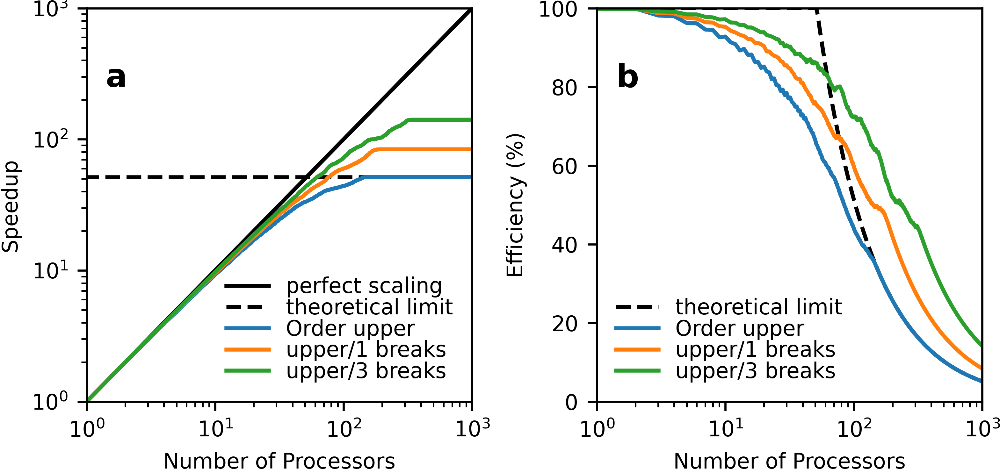

In [34]:
fig = plt.figure(figsize=(13.5 / 2.54, 6.5 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(1, 2, sharex=False, sharey=False, squeeze=False)

MAX_NP = 1000

ax = axs[0, 0]
data_x = list(range(1, MAX_NP + 1))
ax.plot(data_x, perfect_speedup[:MAX_NP], label="perfect scaling", color="k")
ax.plot(theory_limit_cj, label="theoretical limit", color="k", linestyle="--")
ax.plot(data_x, zheng_rorder_cj_speedup, label="Order upper")
ax.plot(data_x, zheng_rorder_cj_bd1_speedup, label="upper/1 breaks")
ax.plot(data_x, zheng_rorder_cj_bd3_speedup, label="upper/3 breaks")
ax.set_xlim(1, MAX_NP)
ax.set_ylim(1, MAX_NP)
ax.set_yscale("log")
ax.set_xscale("log")
ax.legend(fontsize=8, loc="lower right", frameon=False, labelspacing=0.01)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Speedup")
ax.text(0.05, 0.8, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")

ax.tick_params(labelsize=8)


ax = axs[0, 1]
data_x = list(range(1, MAX_NP + 1))
ax.plot(
    data_x,
    [
        min((x / y) * 100.0, 100)
        for x, y in zip(theory_limit_cj, perfect_speedup[:MAX_NP])
    ],
    label="theoretical limit",
    color="k",
    linestyle="--",
)
ax.plot(
    data_x,
    [
        (x / y) * 100.0
        for x, y in zip(zheng_rorder_cj_speedup, perfect_speedup[:MAX_NP])
    ],
    label="Order upper",
)
ax.plot(
    data_x,
    [(x / y) * 100.0 for x, y in zip(zheng_rorder_cj_bd1_speedup, perfect_speedup)],
    label="upper/1 breaks",
)
ax.plot(
    data_x,
    [(x / y) * 100.0 for x, y in zip(zheng_rorder_cj_bd3_speedup, perfect_speedup)],
    label="upper/3 breaks",
)
ax.set_xlim(1, MAX_NP)
ax.set_ylim(0, 100)
ax.set_xscale("log")
ax.legend(fontsize=8, frameon=False, labelspacing=0.01)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Efficiency (%)")
ax.text(0.05, 0.8, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")


ax.tick_params(labelsize=8)

fig.savefig(
    FIGUREROOT.joinpath("speedup_bd_yangtze").with_suffix(".pdf"),
    dpi=figdpi,
)

In [35]:
print(
    np.nonzero(
        [
            x / zheng_rorder_cj_bd1_speedup[-1] >= 0.90
            for x in zheng_rorder_cj_bd1_speedup
        ]
    )[0][0].item(),
    np.nonzero(
        [
            x / zheng_rorder_cj_bd3_speedup[-1] >= 0.90
            for x in zheng_rorder_cj_bd3_speedup
        ]
    )[0][0].item(),
)

151 277


In [36]:
print(
    "Order u ",
    np.where([x / y > 0.8 for x, y in zip(zheng_rorder_cj_speedup, perfect_speedup)])[
        0
    ][-1],
)
print(
    "1 breaks ",
    np.where(
        [x / y > 0.8 for x, y in zip(zheng_rorder_cj_bd1_speedup, perfect_speedup)]
    )[0][-1],
)
print(
    "3 breaks ",
    np.where(
        [x / y > 0.8 for x, y in zip(zheng_rorder_cj_bd3_speedup, perfect_speedup)]
    )[0][-1],
)

Order u  25
1 breaks  40
3 breaks  77


In [37]:
def optimize_order_inplace(
    order: dict[UUID, int],
    zheng_order: dict[UUID, int],
    reach_cost: dict[UUID, float],
    downstream: dict[UUID, UUID | None],
    upstream: dict[UUID, list[UUID]] | None = None,
):
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )

    # find the reach with the maximum cost
    max_cost = 0
    max_cost_rid = None
    for uid, cost in reach_cost.items():
        if cost > max_cost and order[uid] > zheng_order[uid]:
            max_cost = cost
            max_cost_rid = uid
    if max_cost_rid is None:
        return
    if order[max_cost_rid] > zheng_order[max_cost_rid]:
        # reduce the order the stream and its upstreams
        todo = deque([max_cost_rid])
        while len(todo) > 0:
            rid = todo.popleft()
            order[rid] -= 1
            for uid in upstreams[rid]:
                if order[uid] == order[rid]:
                    todo.append(uid)
    return

In [38]:
num_proc = 50

order_inwork = zheng_rorder_cj.copy()
total_cost_history = []
lowest_cost = float("inf")


total_cost, reach_deficiency = measure_executation(order_inwork, num_proc)
total_cost_history.append(total_cost)
for _ in range(600):
    optimize_order_inplace(
        order_inwork, zheng_order_cj, reach_deficiency, downstream_cj, upstream_cj
    )
    total_cost, reach_deficiency = measure_executation(order_inwork, num_proc)
    total_cost_history.append(total_cost)
    if total_cost < lowest_cost:
        lowest_cost = total_cost
        lowest_order = order_inwork.copy()

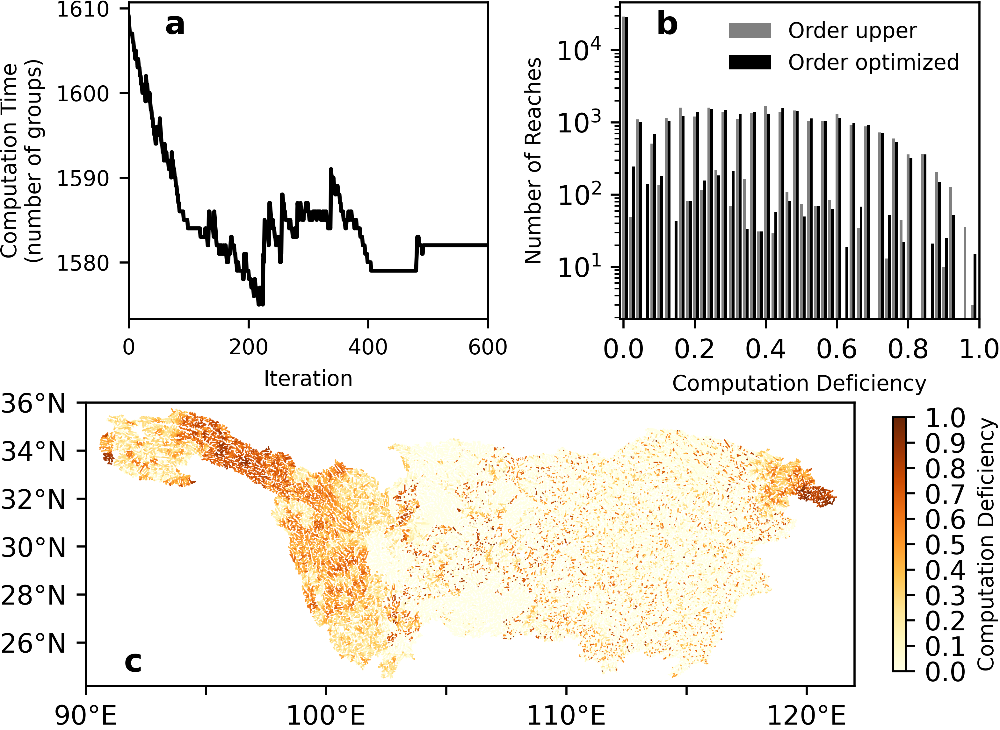

In [39]:
fig = plt.figure(figsize=(13.5 / 2.54, 10 / 2.54), dpi=figdpi, layout="constrained")


ax = plt.subplot(2, 2, 1)

ax.plot(total_cost_history, "k-")
ax.set_xlabel("Iteration\n")
ax.set_ylabel("Computation Time\n(number of groups)")
ax.set_xlim(0, 600)
ax.tick_params(labelsize=8)

ax.text(0.1, 0.90, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")
ax.margins(0.05)


ax = plt.subplot(2, 2, 2)
_, reach_deficiency = measure_executation(zheng_rorder_cj, num_proc)

x1 = np.histogram(list(reach_deficiency.values()), range=(0, 1), bins=num_proc)

_, reach_deficiency = measure_executation(
    lowest_order,
    num_proc,
)

x2 = np.histogram(list(reach_deficiency.values()), range=(0, 1), bins=num_proc)

plt.bar(
    [x for x in x1[1][:-1]],
    x1[0],
    width=0.4 / num_proc,
    color="gray",
    label="Order upper",
)
plt.bar(
    [x + 0.4 / num_proc for x in x2[1][:-1]],
    x2[0],
    width=0.4 / num_proc,
    color="k",
    label="Order optimized",
)
plt.yscale("log")

plt.legend(frameon=False, fontsize=8)

ax.set_xlim(0 - 0.01, 1)
ax.set_xticks(np.arange(0, 1.01, 10 / num_proc))
ax.set_xlabel("Computation Deficiency\n")
ax.set_ylabel("Number of Reaches")

ax.text(0.1, 0.90, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")

ax = plt.subplot(2, 1, 2)
# Create a continuous norm to map from data points to colors
_, reach_deficiency = measure_executation(lowest_order, num_proc)
seg = np.zeros((len(geometry_cj), 2, 2))
value = np.zeros((len(geometry_cj),))
for ii, (rid, geom) in enumerate(geometry_cj.items()):
    x, y = geom
    seg[ii, :, 0] = x
    seg[ii, :, 1] = y
    value[ii] = reach_deficiency[rid]

norm = pltcolors.Normalize(0, 1)
cmap = "YlOrBr"

lc = LineCollection(seg, cmap=cmap, norm=norm)
lc.set_array(value)
lc.set_linewidth(0.5)
line = ax.add_collection(lc)

plot_yangtze(ax)

cb = plt.colorbar(line, ax=ax, label="Computation Deficiency", shrink=0.7)
cb.set_ticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

ax.text(0.05, 0.05, "c", transform=ax.transAxes, fontsize=12, fontweight="bold")

plt.savefig(
    FIGUREROOT.joinpath("optimization_iteration_yangtze").with_suffix(figsuffix),
    dpi=figdpi,
)

In [40]:
def optimize_order(
    order: dict[UUID, int],
    zheng_order: dict[UUID, int],
    niter: int,
    num_proc: int,
    downstream: dict[UUID, UUID | None],
    upstream: dict[UUID, list[UUID]] | None = None,
):
    upstreams: dict[UUID, list[UUID]] = (
        upstream if upstream is not None else find_upstream(downstream)
    )
    order_inwork = order.copy()
    best_order = order.copy()
    best_cost = float("inf")

    for _ in range(niter):
        total_cost, reach_cost = measure_executation(order_inwork, num_proc)
        if total_cost < best_cost:
            best_cost = total_cost
            best_order = order_inwork.copy()
        optimize_order_inplace(
            order_inwork, zheng_order, reach_cost, downstream, upstreams
        )

    return best_order, best_cost

In [41]:
MAX_NP = 400
zheng_rorderopt_cj_speedup = [
    len(zheng_rorder_cj)
    / optimize_order(
        zheng_rorder_cj,
        zheng_order_cj,
        5 * min(np, 200),
        np,
        downstream_cj,
        upstream_cj,
    )[1]
    for np in range(1, MAX_NP + 1)
]

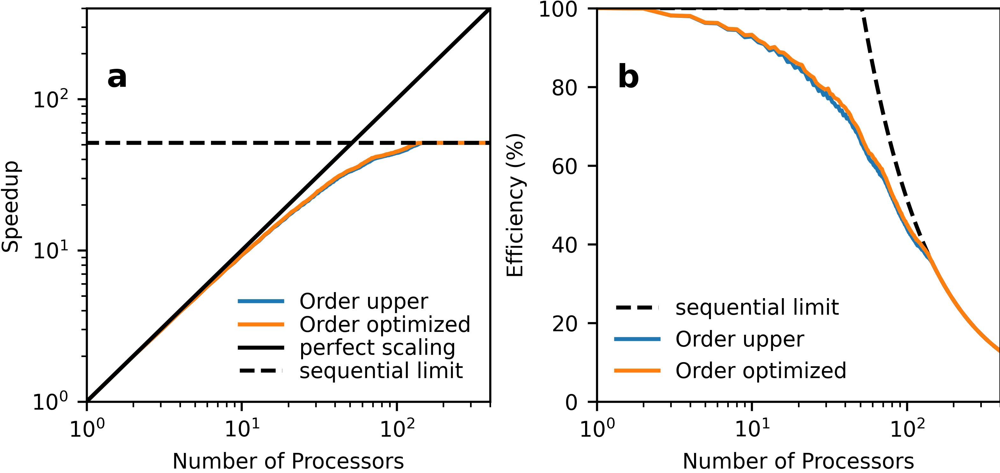

In [42]:
fig = plt.figure(figsize=(13.5 / 2.54, 6.5 / 2.54), dpi=figdpi, layout="constrained")
axs = fig.subplots(1, 2, sharex=False, sharey=False, squeeze=False)

ax = axs[0, 0]
data_x = list(range(1, MAX_NP + 1))
ax.plot(data_x, zheng_rorder_cj_speedup[:MAX_NP], label="Order upper")
ax.plot(data_x, zheng_rorderopt_cj_speedup[:MAX_NP], label="Order optimized")
ax.plot(data_x, perfect_speedup[:MAX_NP], label="perfect scaling", color="k")
ax.plot(theory_limit_cj, label="sequential limit", color="k", linestyle="--")
ax.set_xlim(1, MAX_NP)
ax.set_ylim(1, MAX_NP)
ax.set_yscale("log")
ax.set_xscale("log")
ax.legend(fontsize=8, loc="lower right", frameon=False, labelspacing=0.1)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Speedup")
ax.text(0.05, 0.8, "a", transform=ax.transAxes, fontsize=12, fontweight="bold")

ax.tick_params(labelsize=8)


ax = axs[0, 1]
data_x = list(range(1, MAX_NP + 1))
ax.plot(
    data_x,
    [
        min((x / y) * 100.0, 100)
        for x, y in zip(theory_limit_cj[:MAX_NP], perfect_speedup[:MAX_NP])
    ],
    label="sequential limit",
    color="k",
    linestyle="--",
)
ax.plot(
    data_x,
    [
        (x / y) * 100.0
        for x, y in zip(zheng_rorder_cj_speedup[:MAX_NP], perfect_speedup[:MAX_NP])
    ],
    label="Order upper",
)
ax.plot(
    data_x,
    [
        (x / y) * 100.0
        for x, y in zip(zheng_rorderopt_cj_speedup[:MAX_NP], perfect_speedup[:MAX_NP])
    ],
    label="Order optimized",
)
ax.set_xlim(1, MAX_NP)
ax.set_ylim(0, 100)
ax.set_xscale("log")
ax.legend(fontsize=8, frameon=False)
ax.set_xlabel("Number of Processors")
ax.set_ylabel("Efficiency (%)")
ax.text(0.05, 0.8, "b", transform=ax.transAxes, fontsize=12, fontweight="bold")


ax.tick_params(labelsize=8)

fig.savefig(
    FIGUREROOT.joinpath("speedup_opt_yangtze").with_suffix(".pdf"),
    dpi=figdpi,
)